In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Datasets/

Mounted at /content/drive
/content/drive/MyDrive/Datasets


In [ ]:
import numpy as np
import tensorflow as tf

import os
import cv2
import random

from PIL import Image
from tqdm import tqdm

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

In [ ]:
# trick to accelerate

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Wed Oct 11 13:22:29 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# function to load and normalize images

In [ ]:
def load_images_and_labels(categories, im_ = 1):
    img_lst=[]
    labels=[]
    for category in tqdm(categories):
        folder = os.listdir(path+"/"+category)
        random.seed(20)                        # shuffle because they are organized as coming from list_dir function
        folder = random.choices(folder, k = im_) # here limites the number of images per categories
        for image_name in folder:
            img = cv2.imread(path+"/"+category+"/"+image_name)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)     # keeps RGB columns
            img = cv2.resize(img,(224, 224), interpolation=cv2.INTER_AREA)  # resize image to 224 x 224 for vgg16 or 299 for inception v3
            img_array = Image.fromarray(img, 'RGB')        #.  'RGB' / 'L'   for color or grey scale
            img_lst.append(np.array(img_array))
            labels.append(category[10:])
    print("images loaded")
    return img_lst, labels


In [ ]:
def normalize_(images,labels):
  images = np.array(images)
  labels = np.array(labels)
  print("\n==> Necessary to normalize images' pixels")
  images = images.astype(np.float32)                      #### not necessary if using image transfo function ?!?
  images = images/255
  print("\n\n*** images format after normalisation ***\n\n",images[1][:2])
  print("\nShapes:\nImages shape ",images.shape,"Labels shape = ",labels.shape)
  return (images,labels)


In [ ]:
# load images and model

In [ ]:
path = "Images"
categories = os.listdir(path)

img_lst, labels = load_images_and_labels(categories, im_=210)
images, labels = normalize_(img_lst,labels)

100%|██████████| 10/10 [01:01<00:00,  6.19s/it]


images loaded

==> Necessary to normalize images' pixels


*** images format after normalisation ***

 [[[0.13725491 0.12941177 0.07843138]
  [0.14509805 0.13725491 0.08627451]
  [0.15686275 0.14901961 0.09803922]
  ...
  [0.21568628 0.20392157 0.14509805]
  [0.21176471 0.2        0.14117648]
  [0.20392157 0.19215687 0.13333334]]

 [[0.13725491 0.12941177 0.07843138]
  [0.14901961 0.14117648 0.09019608]
  [0.16078432 0.15294118 0.10196079]
  ...
  [0.21568628 0.20392157 0.14509805]
  [0.21176471 0.2        0.14117648]
  [0.20784314 0.19607843 0.13725491]]]

Shapes:
Images shape  (2100, 224, 224, 3) Labels shape =  (2100,)


In [ ]:
from sklearn.preprocessing import LabelEncoder
label_enc = LabelEncoder()
enc_label = label_enc.fit_transform(labels)

# split to learn model
x_train, x_test, y_train, y_test = train_test_split(images, enc_label, train_size = 0.8, random_state = 42, stratify=labels)

x_train = x_train.astype('float32')
y_train = y_train.astype('int32')
x_test = x_test.astype('float32')
y_test = y_test.astype('int32')

In [ ]:
new_model2 = tf.keras.models.load_model('saved_models/inception/model_inception_final.keras')
new_model = tf.keras.models.load_model('saved_models/vgg16/model_vgg16_final.keras')

In [ ]:

loss, acc = new_model.evaluate(images, enc_label)#, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

66/66 [==============================] - 24s 165ms/step - loss: 4.4693 - accuracy: 0.7729
Restored model, accuracy: 77.29%


In [ ]:
# function fo find common matche and or mistakes

pred=new_model.predict(images) # vgg16
pred2=new_model2.predict(images) # inception

def itere_photos(dat_=pred , breed1='Irish_wolfhound',breed2='Scottish_deerhound'):
  n=0
  nn=1
  idx_photos=[]
  pred = dat_[:]
  for label, pred_ in zip(enc_label,pred):
    # Dedire ici les conditions vrai label vs prediction

    if label_enc.inverse_transform([label]) == breed1 \
      and np.argmax(pred_) == label_enc.transform([breed2])[0]:
      # explain the decisions
      idx_photos.append(n)
      if nn>11:
        pass
      nn+=1
    n+=1
  return idx_photos



id_i = itere_photos(breed1='Afghan_hound',breed2='Afghan_hound')
id_v = itere_photos(dat_=pred2,breed1='Afghan_hound',breed2='Afghan_hound')

66/66 [==============================] - 9s 86ms/step


In [ ]:
# list all the common wrong predictions
"""ids=[]
for id_is in id_i :
  for id_vs in id_v:
    if id_is == id_vs:
      ids.append(id_is)"""

ids=list(set(id_i+id_v))

print(f"vgg model makes {len(id_v)} errors or good pred\ninception model makes {len(id_i)} errors\n the common mistakes are about the picures wich indexes are {ids}" )

#to_check_ids = [1124,1104,1072,1115,1235] ##@ ids where both incption and vgg mistaken 'Irish_wolfhound' for 'Scottish_deerhound'


vgg model makes 208 errors or good pred
inception model makes 203 errors
 the common mistakes are about the picures wich indexes are [210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 3

In [ ]:
float(pred[300][0])

0.9754314422607422

In [ ]:
# function to isolate best match results

def get_100 (score=0.9999):
  id_100 = []
  for id_ in ids:
    if float(pred[id_][0]) > score:
      id_100.append(id_)
  return id_100
id_100 = get_100()
print(len(ids))
print(len(id_100))

210
4


<ipython-input-17-43645c8931ef>:13: UserWarning: Legend does not support handles for str_ instances.
A proxy artist may be used instead.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#controlling-the-legend-entries
  plt.legend(label_enc.classes_,pred[id_])


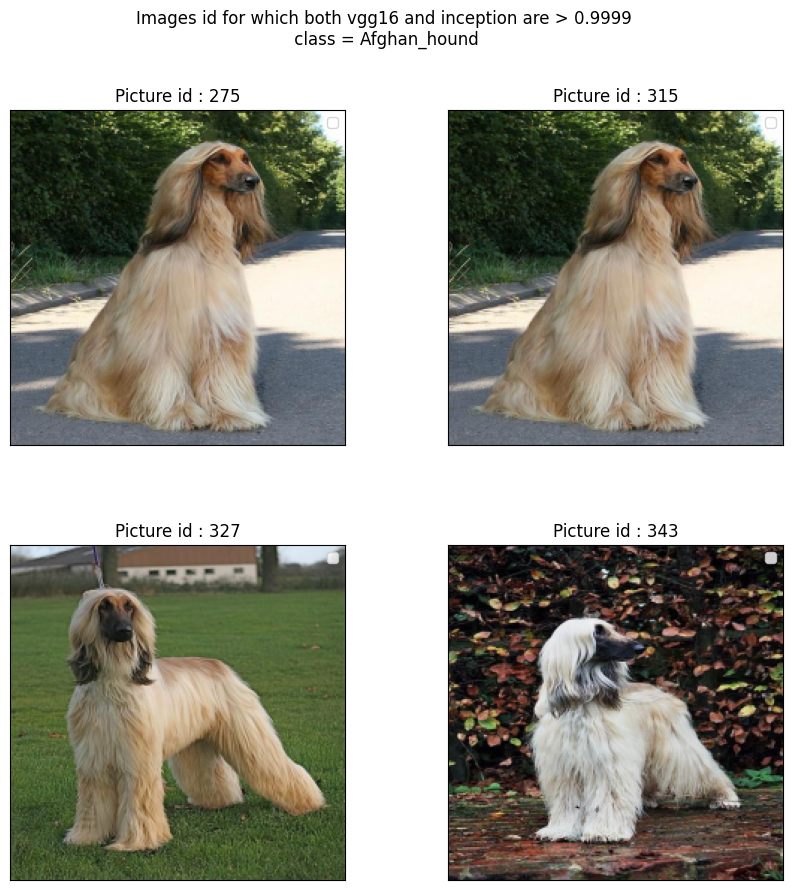

In [ ]:
# function to display images

def display_images(images, labels):
    plt.figure(1 , figsize = (10 , 10))
    n = 0
    for id_ in id_100:    # here put the ids to plot.  for ex: to_check_ids
        n += 1

        plt.subplot(2 , 2 , n) # plt.subplot(3 , 4 , n) for 12 images
        plt.subplots_adjust(hspace = 0.3 , wspace = 0.3)

        plt.imshow(images[id_])
        plt.legend(label_enc.classes_,pred[id_])
        plt.title(f'Picture id : {id_}')
        plt.xticks([])
        plt.yticks([])


    plt.suptitle('Images id for which both vgg16 and inception are > 0.9999\n class = Afghan_hound')
    plt.show()

display_images(images, labels)

In [ ]:
# function to preprocess images for grad cam

In [ ]:
def preprocess_image(img_path, target_size=(224, 224)):
    """Preprocess the image by reshape and normalization.

    Args:
        img_path: A string.
        target_size: A tuple, reshape to this size.
    Return:
        An image array.
    """
    img = image.load_img(img_path, target_size=target_size)
    img = image.img_to_array(img)
    img /= 255

    return img


def show_imgwithheat(img_path, heatmap, alpha=0.4, return_array=False):
    """Show the image with heatmap.

    Args:
        img_path: string.
        heatmap: image array, get it by calling grad_cam().
        alpha: float, transparency of heatmap.
        return_array: bool, return a superimposed image array or not.
    Return:
        None or image array.
    """
    img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = (heatmap*255).astype("uint8")
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * alpha + img
    superimposed_img = np.clip(superimposed_img, 0, 255).astype("uint8")
    superimposed_img = cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

    imgwithheat = Image.fromarray(superimposed_img)
    try:
        display(imgwithheat)
    except NameError:
        imgwithheat.show()

    if return_array:
        return superimposed_img

In [ ]:
# function to get gradient maps


In [ ]:
def grad_cam(model, img,
             layer_name="block5_conv3", label_name=None,
             category_id=None):
    """Get a heatmap by Grad-CAM.

    Args:
        model: A model object, build from tf.keras 2.X.
        img: An image ndarray.
        layer_name: A string, layer name in model.
        label_name: A list or None,
            show the label name by assign this argument,
            it should be a list of all label names.
        category_id: An integer, index of the class.
            Default is the category with the highest score in the prediction.

    Return:
        A heatmap ndarray(without color).
    """
    img_tensor = np.expand_dims(img, axis=0)

    conv_layer = model.get_layer(layer_name)
    heatmap_model = Model([model.inputs], [conv_layer.output, model.output])

    with tf.GradientTape() as gtape:
        conv_output, predictions = heatmap_model(img_tensor)
        if category_id is None:
            category_id = np.argmax(predictions[0])
        if label_name is not None:
            print(label_name[category_id])
        output = predictions[:, category_id]
        grads = gtape.gradient(output, conv_output)
        pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_output), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    max_heat = np.max(heatmap)
    if max_heat == 0:
        max_heat = 1e-10
    heatmap /= max_heat

    return np.squeeze(heatmap)

In [ ]:
# function to get images path and show analysis

In [ ]:
def get_img_path(idx):
    img_idx=0
    path_list=[]
    for category in tqdm(categories):
        folder = os.listdir(path+"/"+category)
        random.seed(20)                        # shuffle because they are organized as coming from list_dir function
        folder = random.choices(folder, k=210) # here limites the number of images per categories
        for image_name in folder:
          if img_idx in idx:
            img_path = path+"/"+category+"/"+image_name
            print (img_idx)
            path_list.append(img_path)
          img_idx+=1
    return path_list

path_list = get_img_path([315,275])


100%|██████████| 10/10 [00:00<00:00, 298.95it/s]

275
315


In [ ]:
path_list[1]

'Images/n02088094-Afghan_hound/n02088094_10715.jpg'

In [ ]:
conv_layers = [layer.name for layer in new_model2.layers if layer.name.startswith('conv2d')]

Afghan_hound


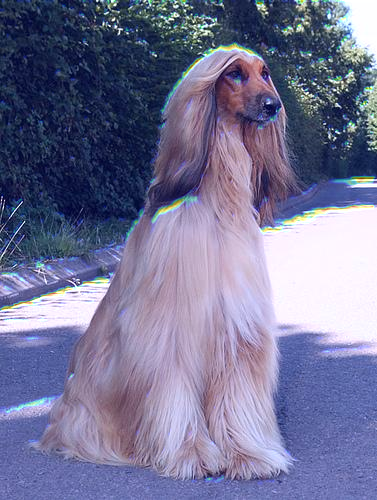

In [ ]:
img_path = path_list[0]
img = preprocess_image(img_path)

# %% result of grad cam
heatmap = grad_cam(new_model, img, layer_name='block1_conv2',
                   label_name = label_enc.classes_,
                   category_id = 0,
                   )
show_imgwithheat(img_path, heatmap)

******************************
conv2d_94
Afghan_hound


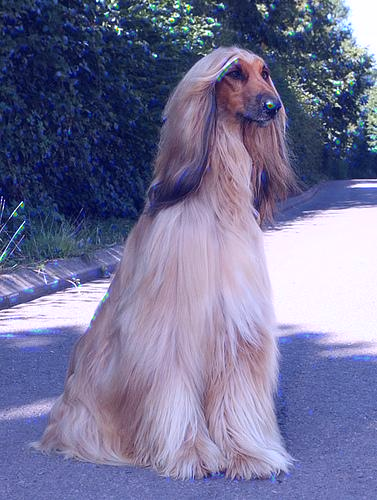

******************************
conv2d_95
Afghan_hound


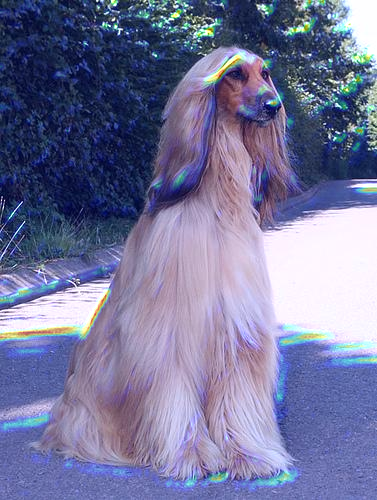

******************************
conv2d_96
Afghan_hound


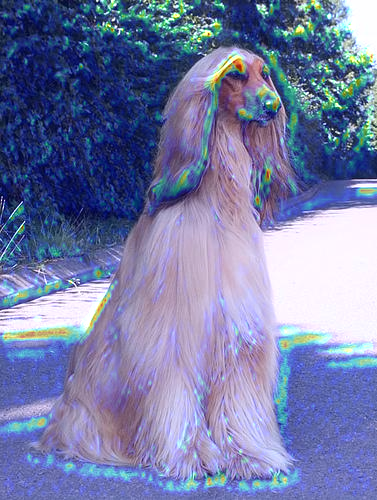

******************************
conv2d_97
Afghan_hound


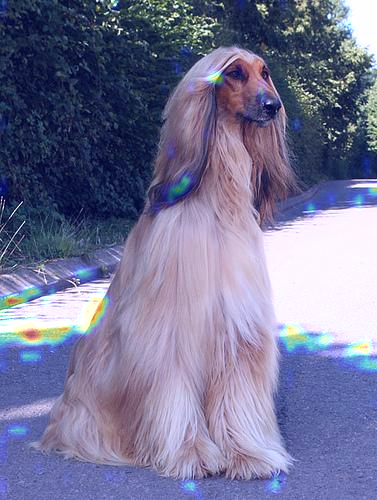

******************************
conv2d_98
Afghan_hound


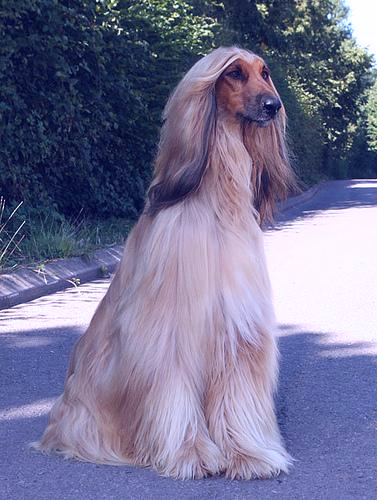

******************************
conv2d_102
Afghan_hound


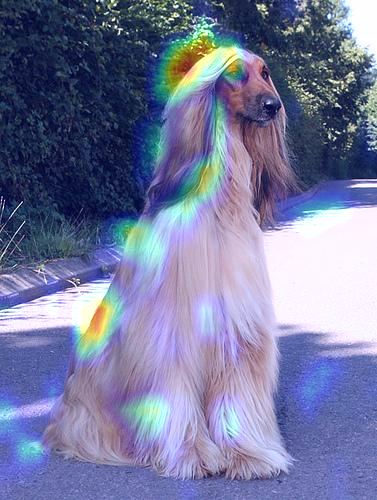

******************************
conv2d_100
Afghan_hound


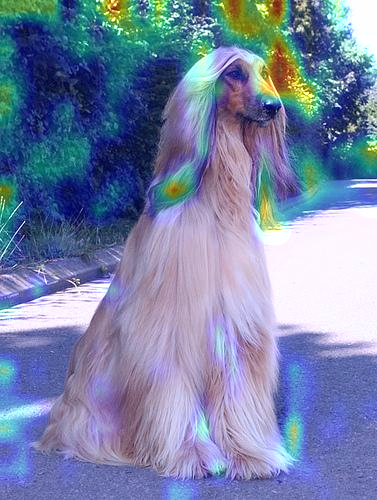

******************************
conv2d_103
Afghan_hound


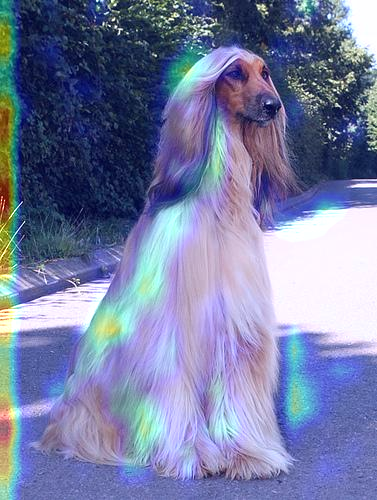

******************************
conv2d_99
Afghan_hound


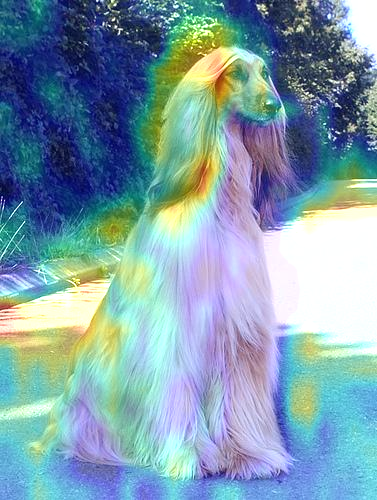

******************************
conv2d_101
Afghan_hound


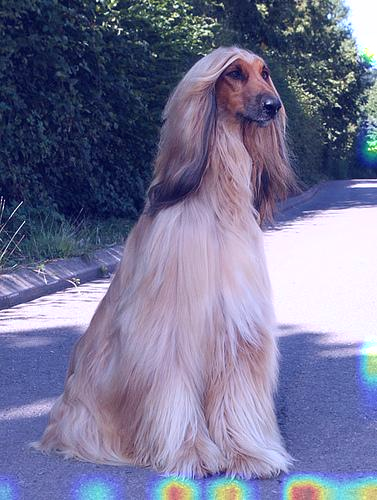

******************************
conv2d_104
Afghan_hound


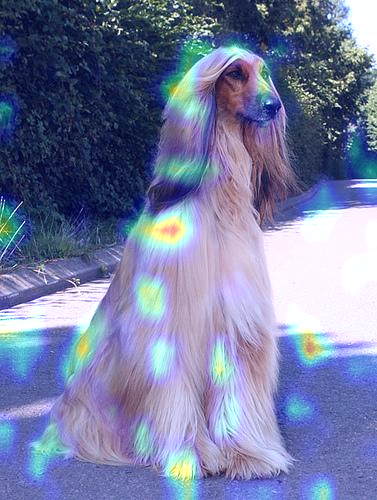

******************************
conv2d_105
Afghan_hound


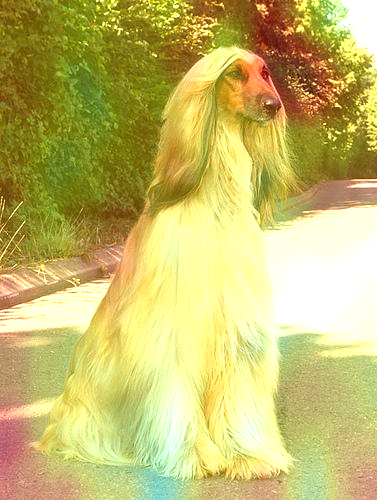

******************************
conv2d_109
Afghan_hound


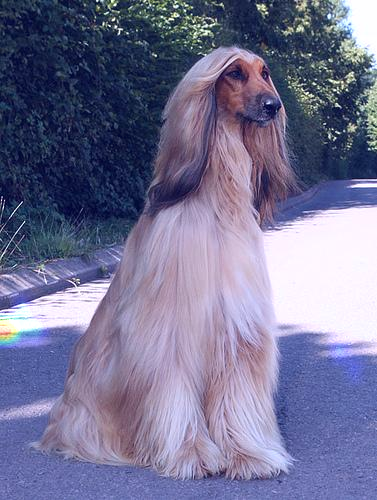

******************************
conv2d_107
Afghan_hound


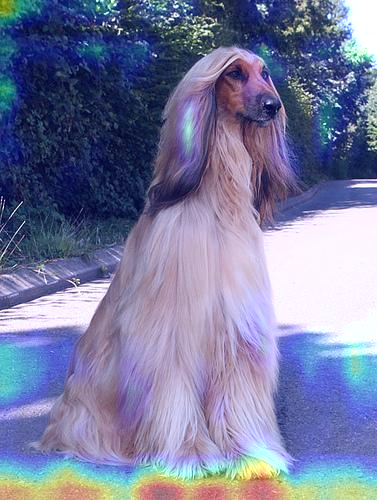

******************************
conv2d_110
Afghan_hound


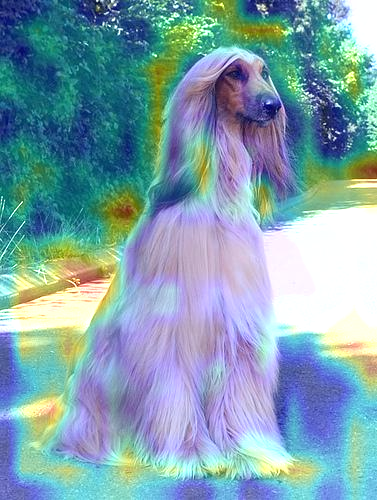

******************************
conv2d_106
Afghan_hound


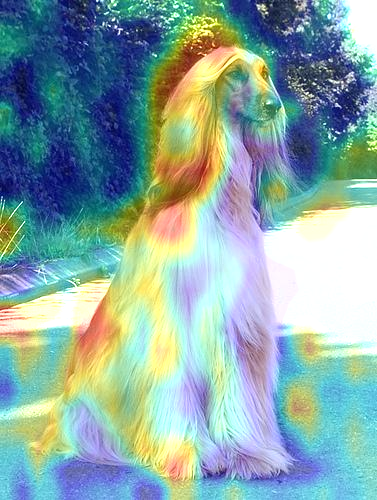

******************************
conv2d_108
Afghan_hound


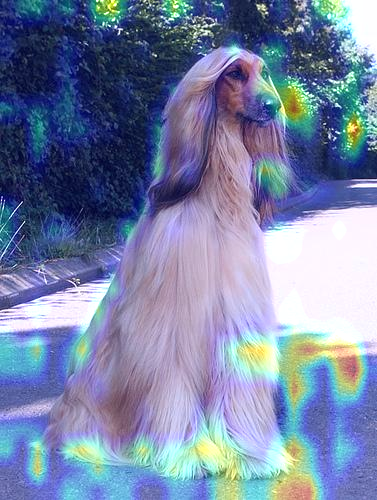

******************************
conv2d_111
Afghan_hound


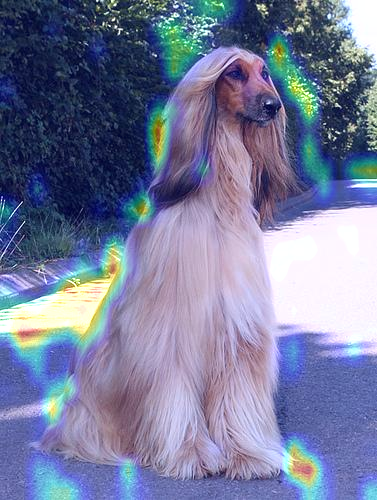

******************************
conv2d_112
Afghan_hound


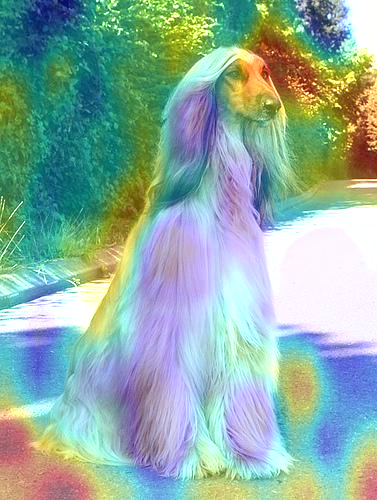

******************************
conv2d_116
Afghan_hound


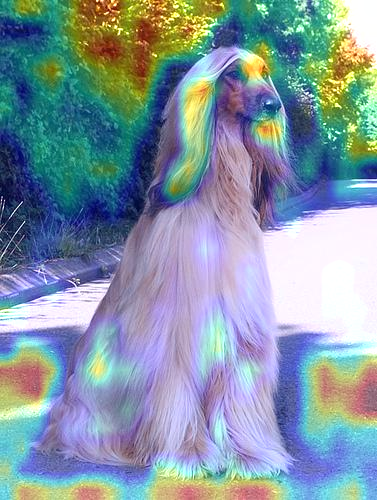

******************************
conv2d_114
Afghan_hound


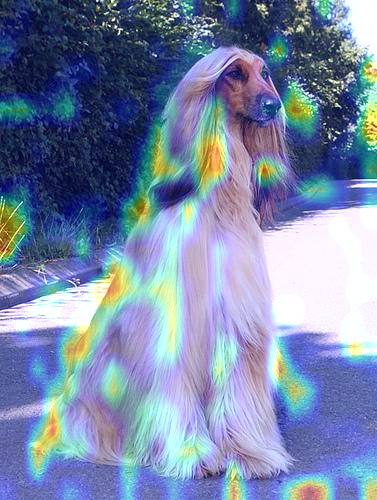

******************************
conv2d_117
Afghan_hound


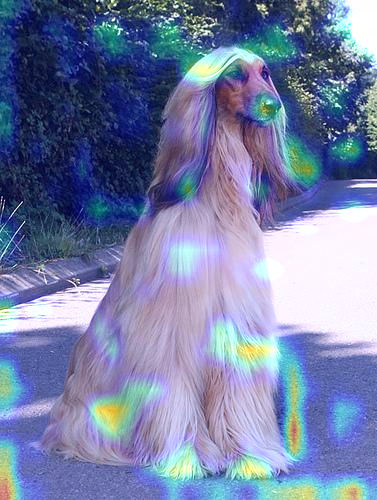

******************************
conv2d_113
Afghan_hound


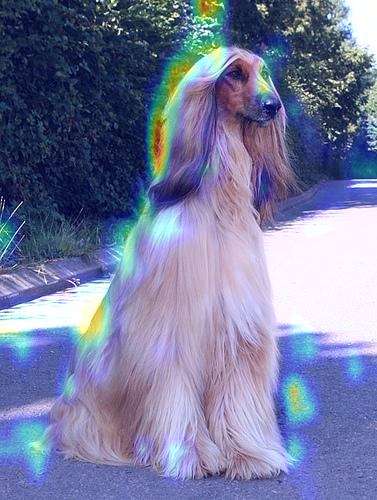

******************************
conv2d_115
Afghan_hound


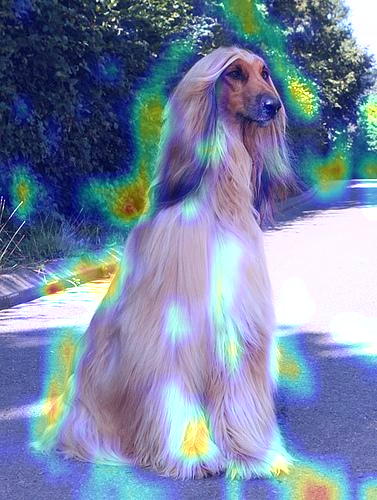

******************************
conv2d_118
Afghan_hound


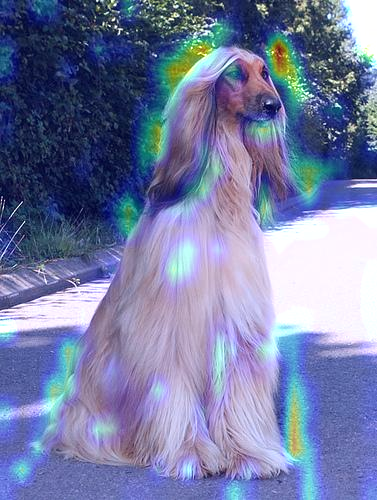

******************************
conv2d_119
Afghan_hound


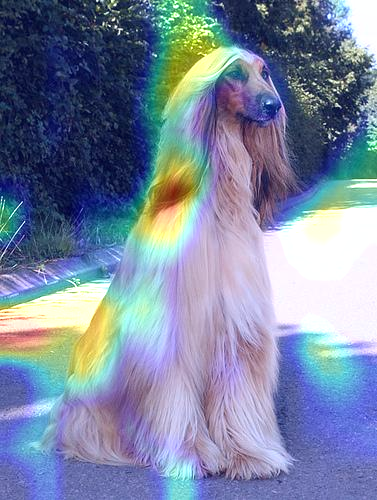

******************************
conv2d_121
Afghan_hound


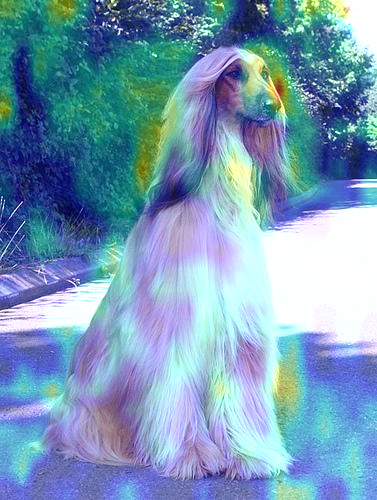

******************************
conv2d_122
Afghan_hound


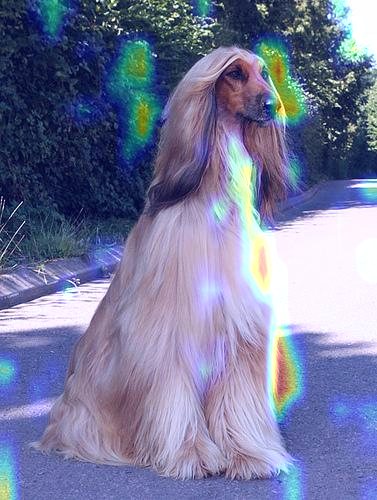

******************************
conv2d_120
Afghan_hound


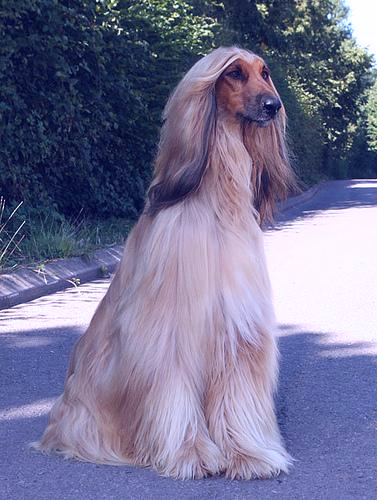

******************************
conv2d_123
Afghan_hound


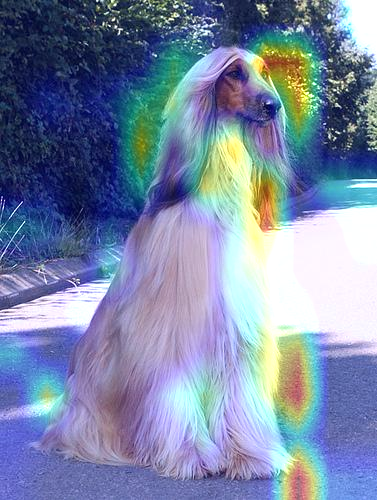

******************************
conv2d_128
Afghan_hound


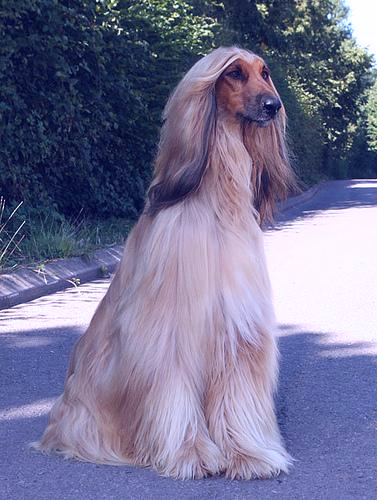

******************************
conv2d_129
Afghan_hound


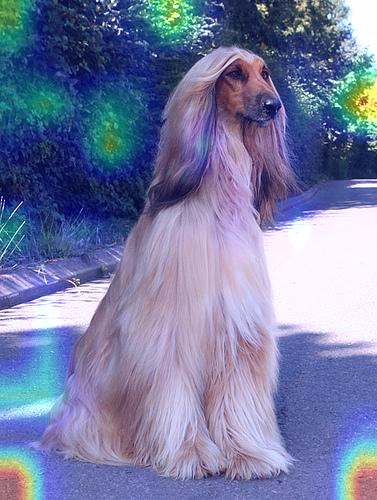

******************************
conv2d_125
Afghan_hound


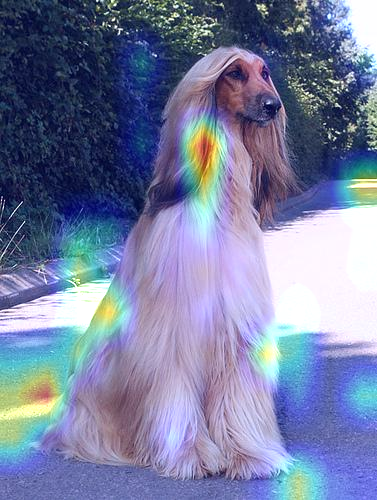

******************************
conv2d_130
Afghan_hound


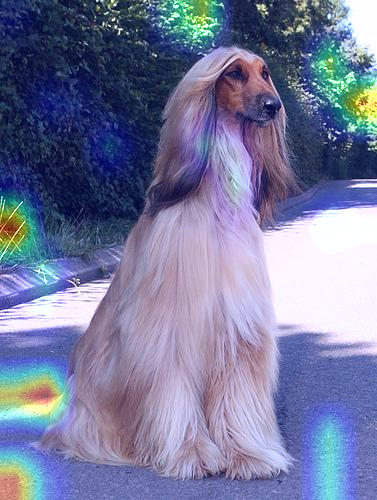

******************************
conv2d_126
Afghan_hound


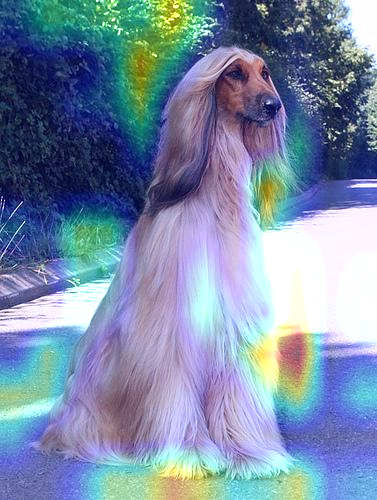

******************************
conv2d_131
Afghan_hound


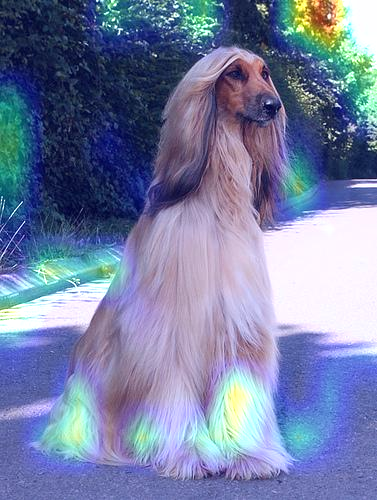

******************************
conv2d_124
Afghan_hound


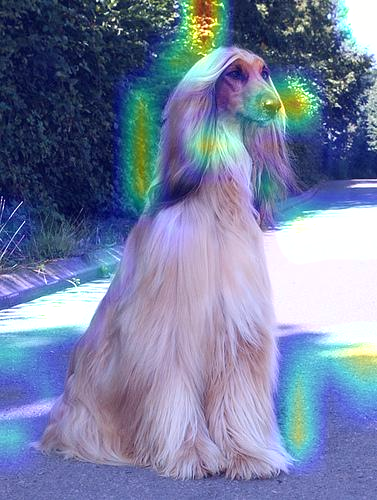

******************************
conv2d_127
Afghan_hound


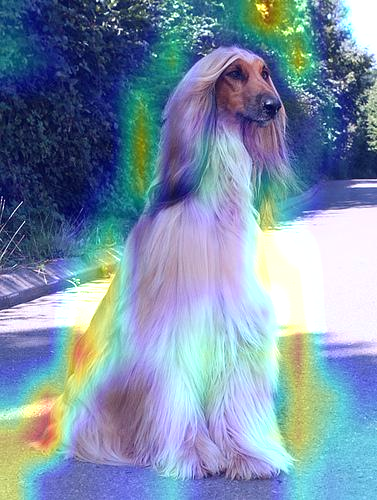

******************************
conv2d_132
Afghan_hound


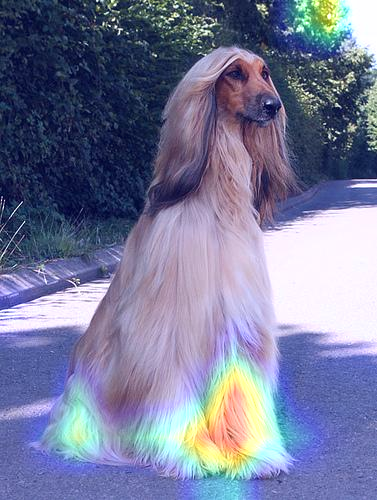

******************************
conv2d_133
Afghan_hound


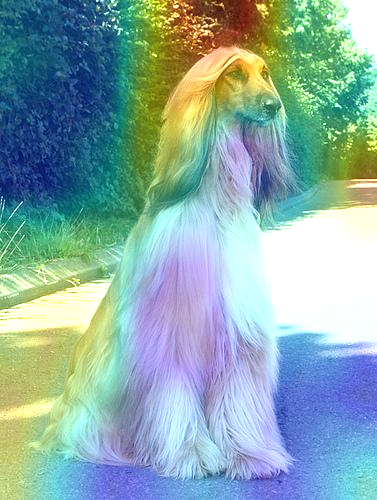

******************************
conv2d_138
Afghan_hound


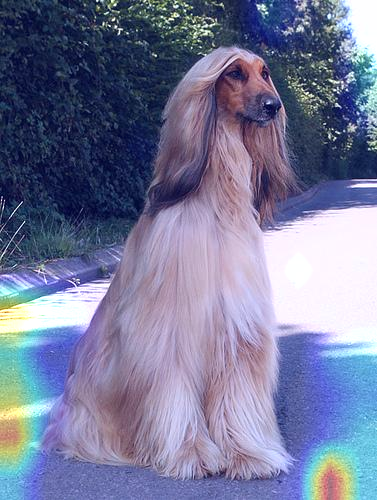

******************************
conv2d_139
Afghan_hound


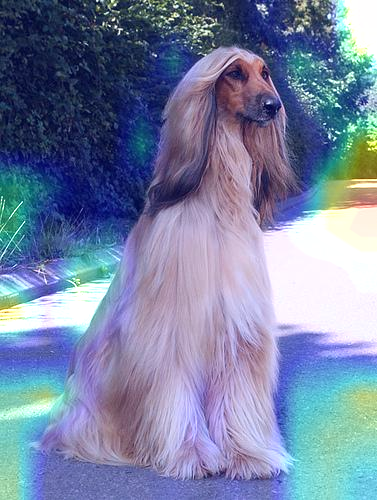

******************************
conv2d_135
Afghan_hound


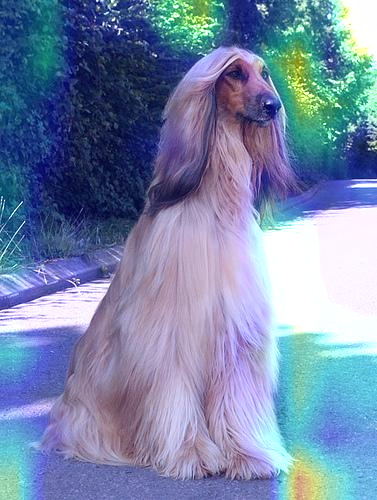

******************************
conv2d_140
Afghan_hound


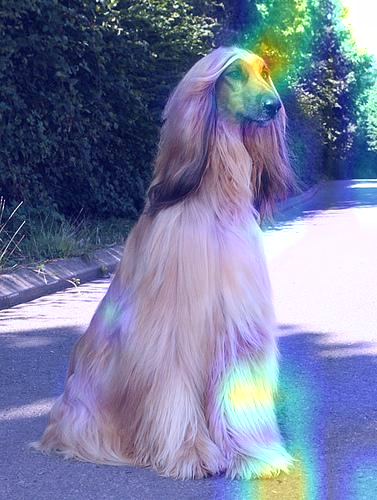

******************************
conv2d_136
Afghan_hound


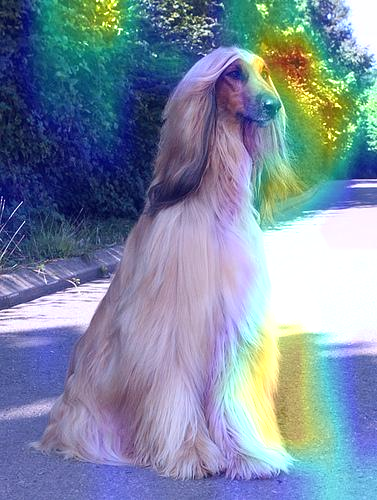

******************************
conv2d_141
Afghan_hound


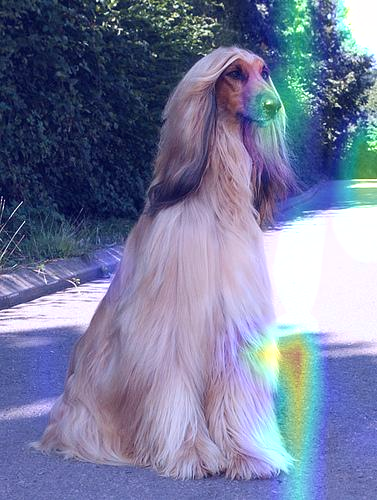

******************************
conv2d_134
Afghan_hound


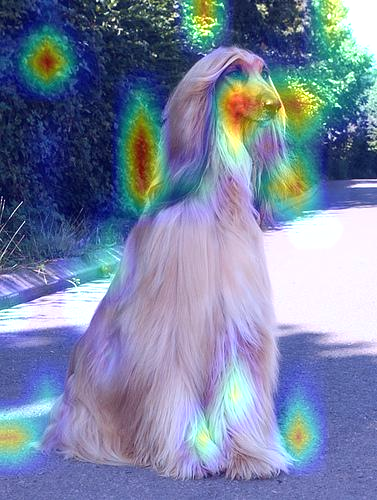

******************************
conv2d_137
Afghan_hound


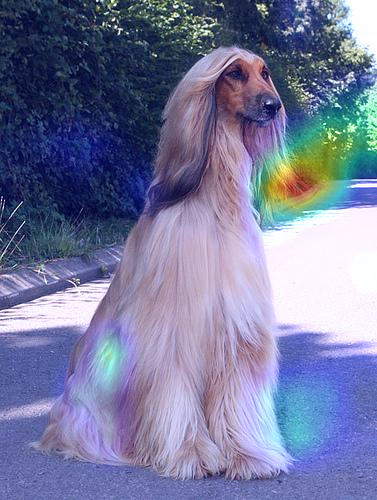

******************************
conv2d_142
Afghan_hound


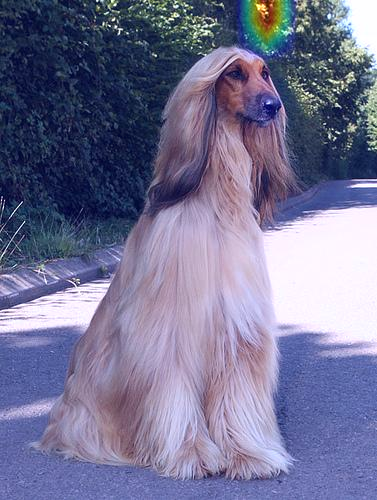

******************************
conv2d_143
Afghan_hound


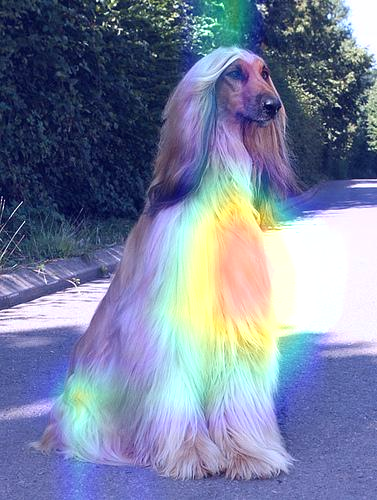

******************************
conv2d_148
Afghan_hound


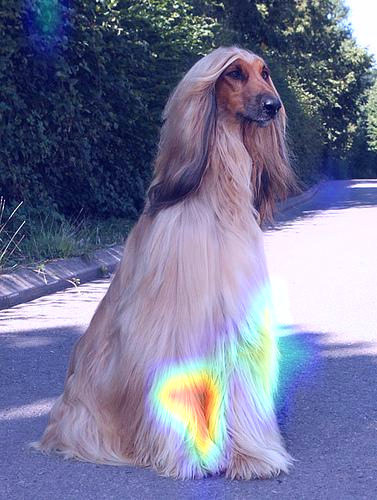

******************************
conv2d_149
Afghan_hound


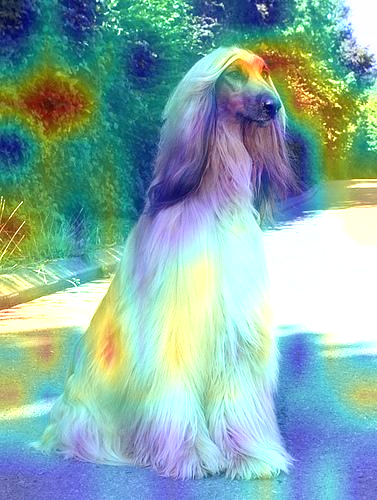

******************************
conv2d_145
Afghan_hound


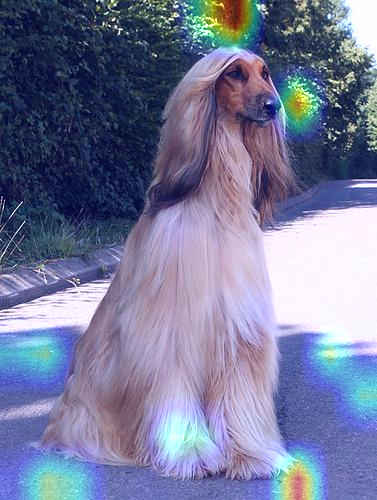

******************************
conv2d_150
Afghan_hound


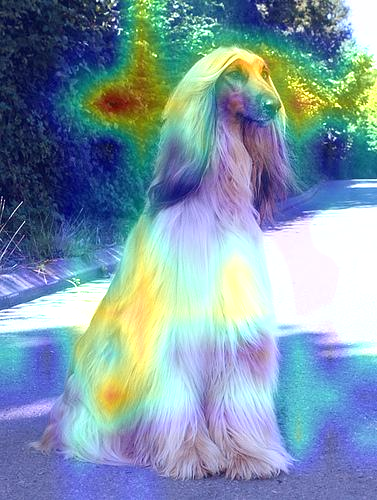

******************************
conv2d_146
Afghan_hound


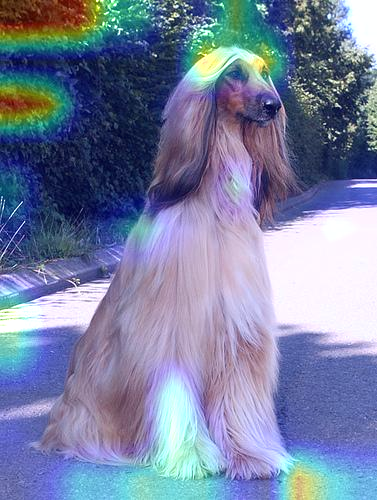

******************************
conv2d_151
Afghan_hound


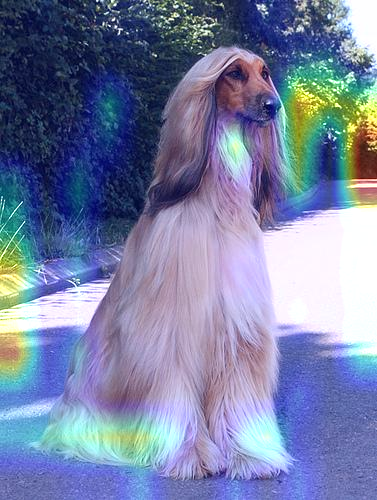

******************************
conv2d_144
Afghan_hound


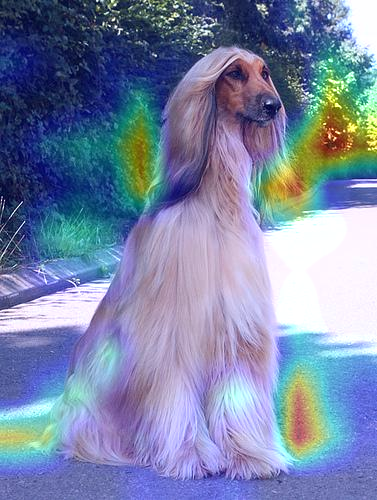

******************************
conv2d_147
Afghan_hound


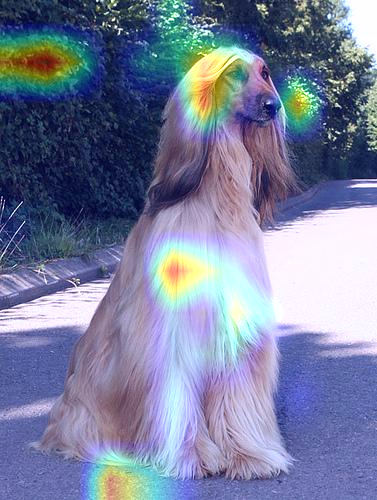

******************************
conv2d_152
Afghan_hound


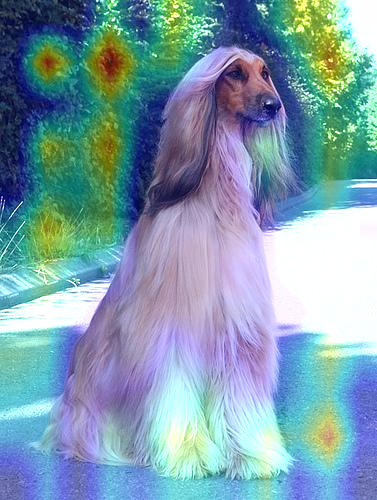

******************************
conv2d_153
Afghan_hound


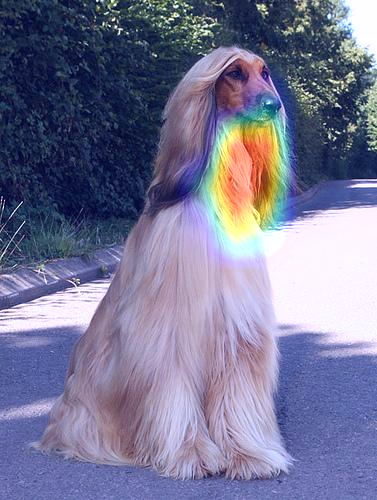

******************************
conv2d_158
Afghan_hound


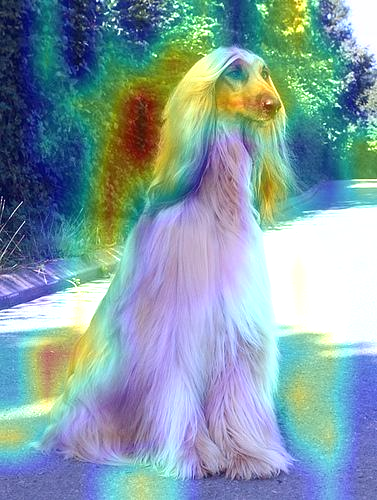

******************************
conv2d_159
Afghan_hound


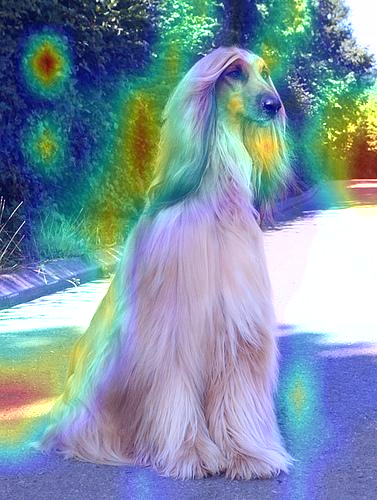

******************************
conv2d_155
Afghan_hound


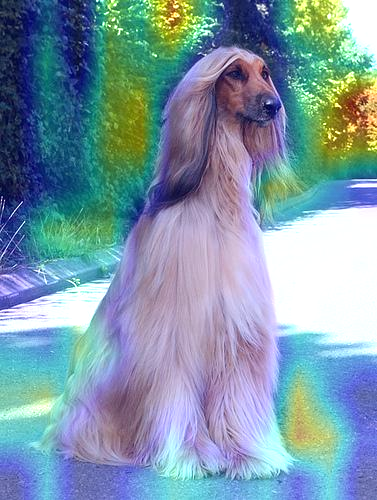

******************************
conv2d_160
Afghan_hound


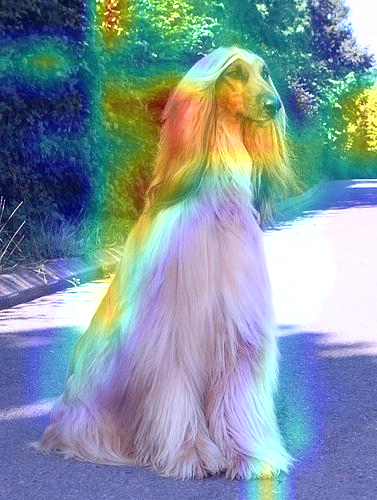

******************************
conv2d_156
Afghan_hound


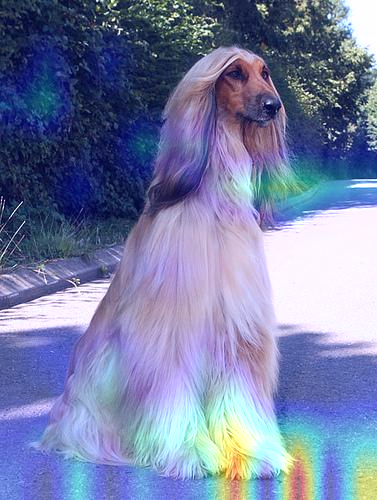

******************************
conv2d_161
Afghan_hound


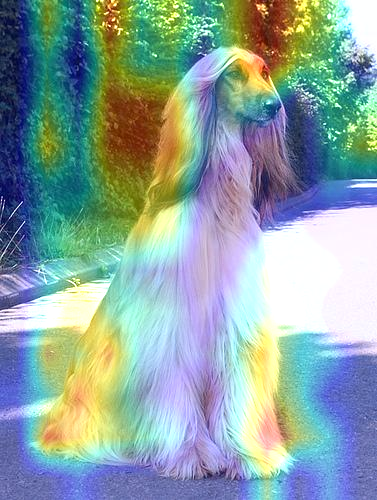

******************************
conv2d_154
Afghan_hound


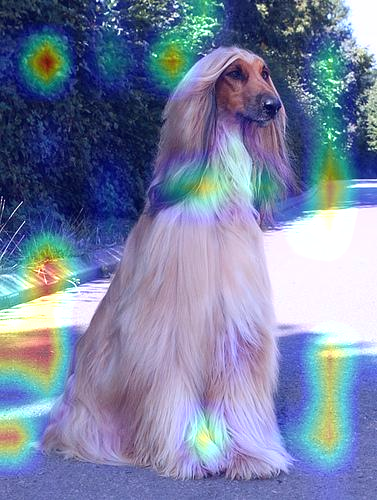

******************************
conv2d_157
Afghan_hound


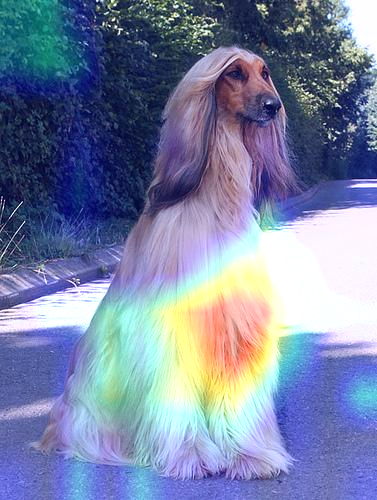

******************************
conv2d_162
Afghan_hound


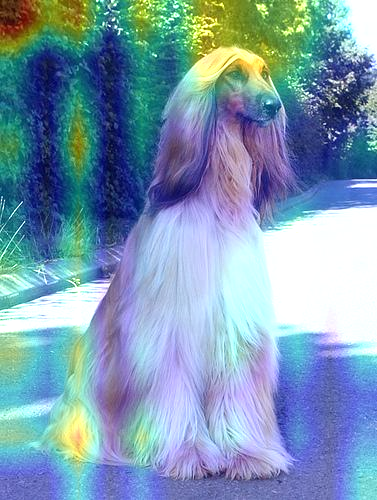

******************************
conv2d_163
Afghan_hound


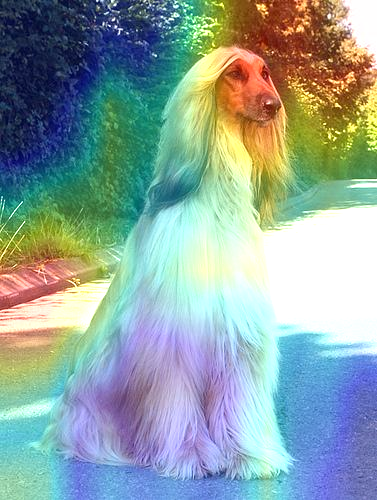

******************************
conv2d_166
Afghan_hound


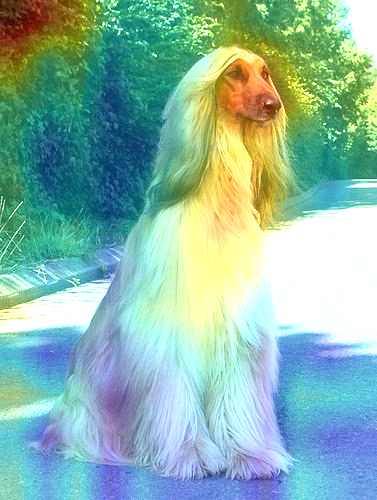

******************************
conv2d_167
Afghan_hound


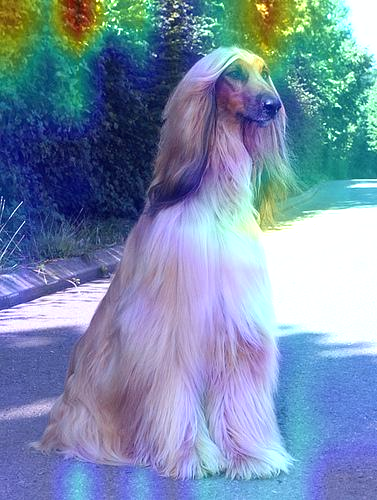

******************************
conv2d_164
Afghan_hound


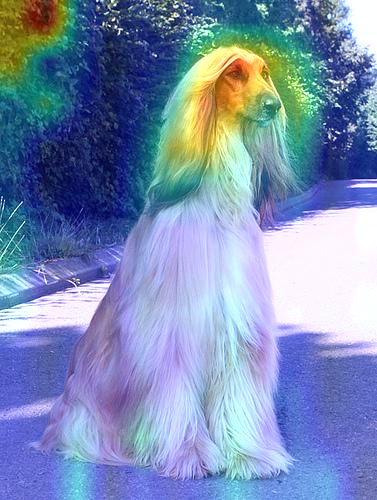

******************************
conv2d_168
Afghan_hound


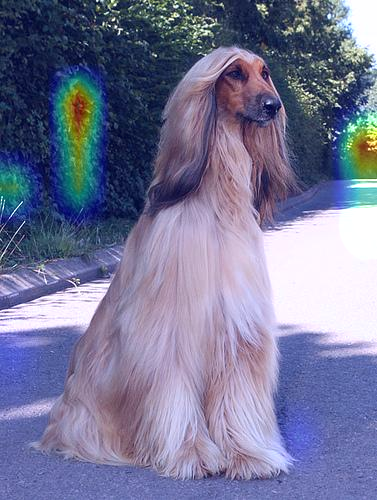

******************************
conv2d_165
Afghan_hound


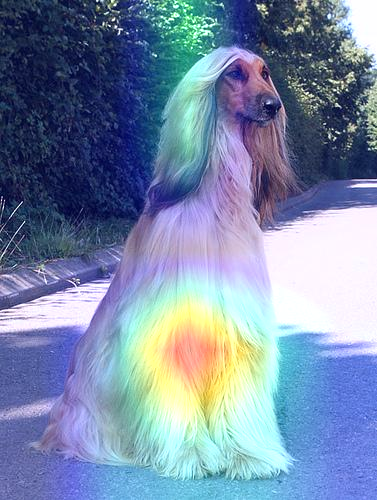

******************************
conv2d_169
Afghan_hound


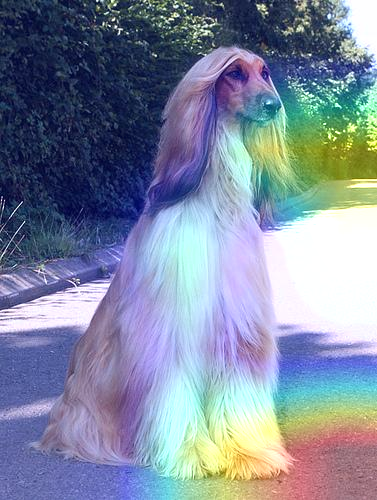

******************************
conv2d_174
Afghan_hound


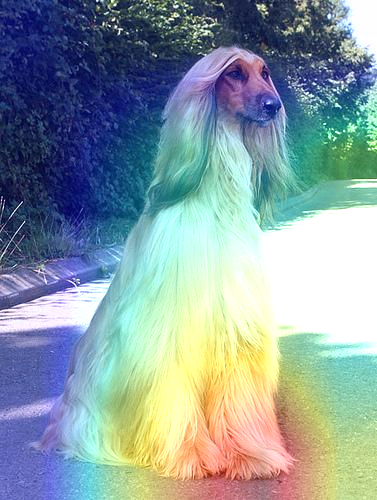

******************************
conv2d_171
Afghan_hound


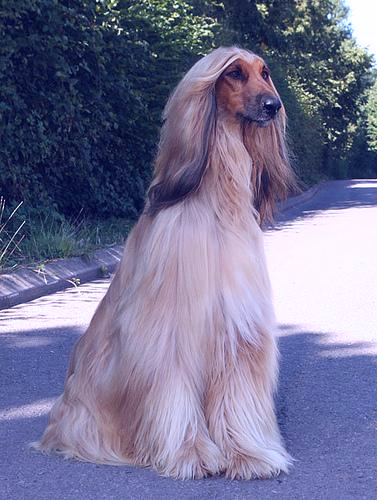

******************************
conv2d_175
Afghan_hound


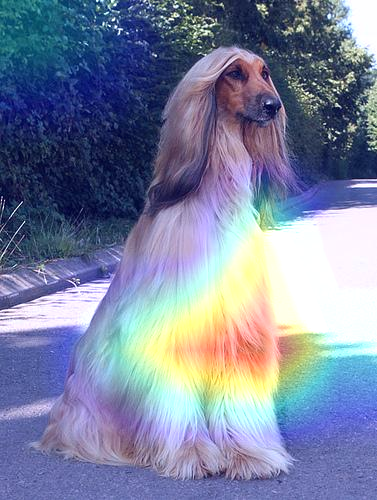

******************************
conv2d_172
Afghan_hound


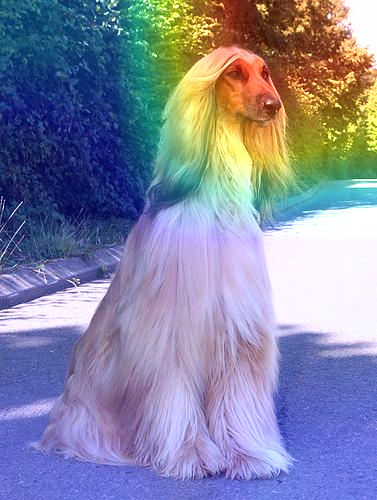

******************************
conv2d_173
Afghan_hound


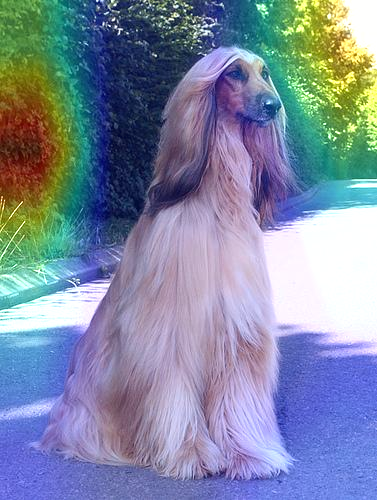

******************************
conv2d_176
Afghan_hound


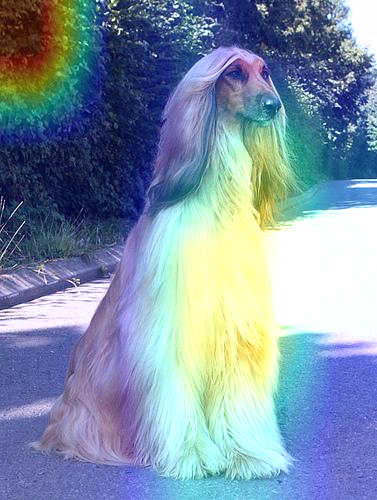

******************************
conv2d_177
Afghan_hound


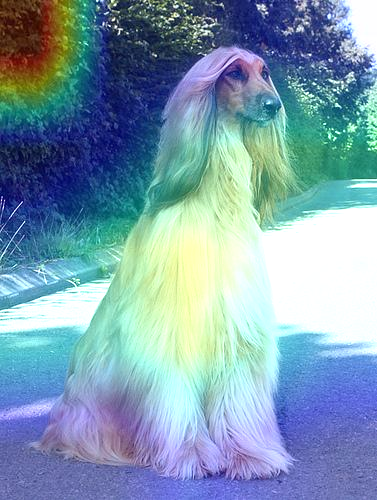

******************************
conv2d_170
Afghan_hound


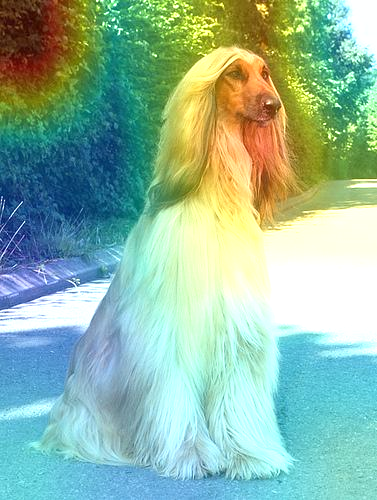

******************************
conv2d_178
Afghan_hound


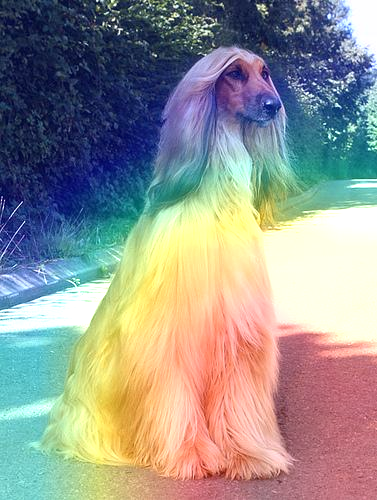

******************************
conv2d_183
Afghan_hound


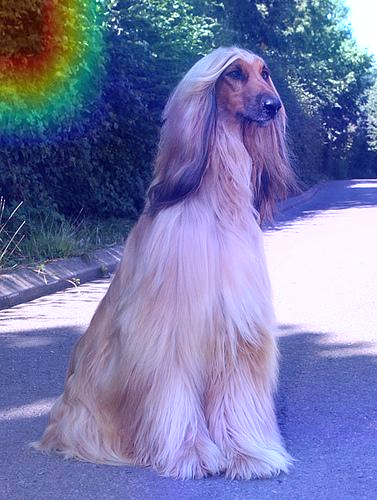

******************************
conv2d_180
Afghan_hound


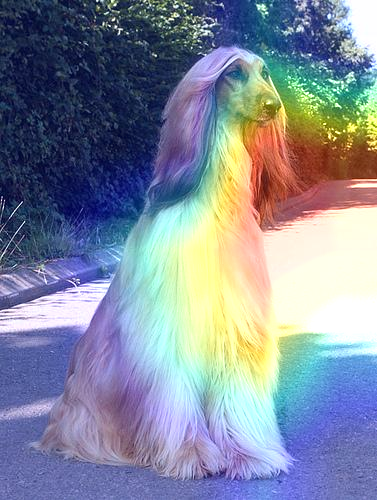

******************************
conv2d_184
Afghan_hound


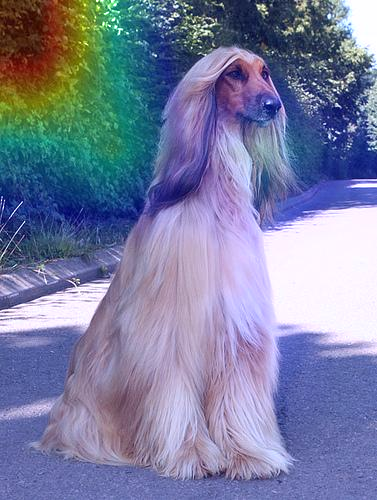

******************************
conv2d_181
Afghan_hound


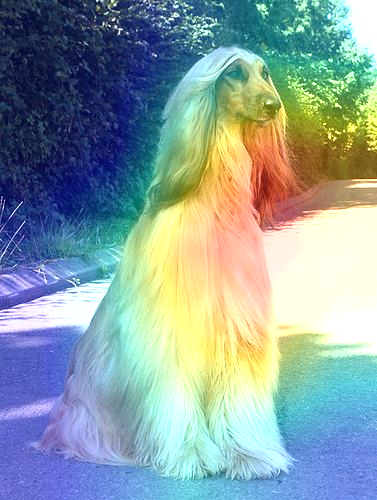

******************************
conv2d_182
Afghan_hound


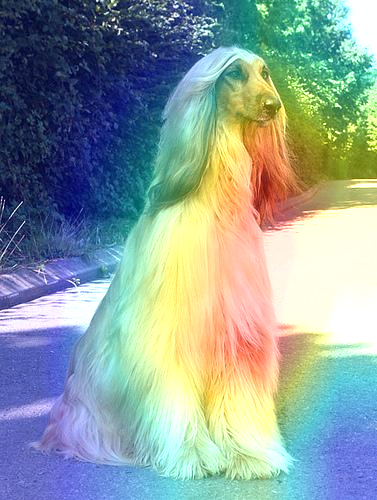

******************************
conv2d_185
Afghan_hound


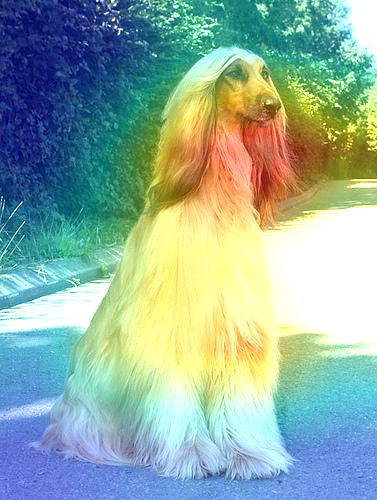

******************************
conv2d_186
Afghan_hound


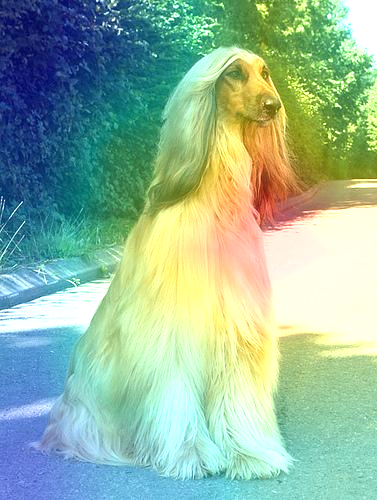

******************************
conv2d_179
Afghan_hound


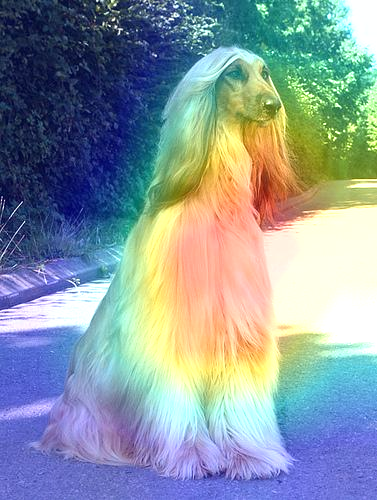

******************************
conv2d_187
Afghan_hound


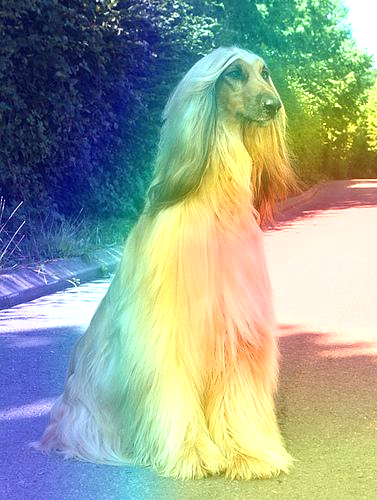

In [ ]:
for lay_ in conv_layers:
  print(30*"*")
  print(lay_)
  heatmap = grad_cam(new_model2, img, layer_name=lay_,
                   label_name = ['Afghan_hound','','','','','','','','','']label_enc.classes_,
                   category_id = 0,
                   )
  show_imgwithheat(img_path, heatmap)


In [ ]:
img_path = path_list[0]
img = preprocess_image(img_path)

# %% result of grad cam
heatmap = grad_cam_plus(new_model, img, layer_name='block5_conv3',
                   label_name = label_enc.classes_,
                   category_id = 0,
                   )
show_imgwithheat(img_path, heatmap)

In [ ]:
def grad_cam_plus(model, img,
                  layer_name="block5_conv3", label_name=None,
                  category_id=None):
    """Get a heatmap by Grad-CAM++.

    Args:
        model: A model object, build from tf.keras 2.X.
        img: An image ndarray.
        layer_name: A string, layer name in model.
        label_name: A list or None,
            show the label name by assign this argument,
            it should be a list of all label names.
        category_id: An integer, index of the class.
            Default is the category with the highest score in the prediction.

    Return:
        A heatmap ndarray(without color).
    """
    img_tensor = np.expand_dims(img, axis=0)

    conv_layer = model.get_layer(layer_name)
    heatmap_model = Model([model.inputs], [conv_layer.output, model.output])

    with tf.GradientTape() as gtape1:
        with tf.GradientTape() as gtape2:
            with tf.GradientTape() as gtape3:
                conv_output, predictions = heatmap_model(img_tensor)
                if category_id is None:
                    category_id = np.argmax(predictions[0])
                if label_name is not None:
                    print(label_name[category_id])
                output = predictions[:, category_id]
                conv_first_grad = gtape3.gradient(output, conv_output)
            conv_second_grad = gtape2.gradient(conv_first_grad, conv_output)
        conv_third_grad = gtape1.gradient(conv_second_grad, conv_output)

    global_sum = np.sum(conv_output, axis=(0, 1, 2))

    alpha_num = conv_second_grad[0]
    alpha_denom = conv_second_grad[0]*2.0 + conv_third_grad[0]*global_sum
    alpha_denom = np.where(alpha_denom != 0.0, alpha_denom, 1e-10)

    alphas = alpha_num/alpha_denom
    alpha_normalization_constant = np.sum(alphas, axis=(0,1))
    alphas /= alpha_normalization_constant

    weights = np.maximum(conv_first_grad[0], 0.0)

    deep_linearization_weights = np.sum(weights*alphas, axis=(0,1))
    grad_cam_map = np.sum(deep_linearization_weights*conv_output[0], axis=2)

    heatmap = np.maximum(grad_cam_map, 0)
    max_heat = np.max(heatmap)
    if max_heat == 0:
        max_heat = 1e-10
    heatmap /= max_heat

    return heatmap

vgg model makes 27 errors\
inception model makes 29 errors\
the common mistakes are about the picures wich indexes are [1072, 1083, 1104, 1107, 1113, 1115, 1124, 1155, 1182, 1218, 1219, 1235]\


In [ ]:
"""def itere_photos(breed1='Irish_wolfhound',breed2='Scottish_deerhound'):
  n=0, nn=1, idx_photos=[]
  plt.figure(1 , figsize = (19 , 10))
  for label, pred_ in zip(enc_label,pred):
    # Dedire ici les conditions vrai label vs prediction
    if label_enc.inverse_transform([label]) == breed1 \
      and np.argmax(pred_) == label_enc.transform([breed2])[0]:
      # explain the decisions
      idx_photos.append(n)
      if nn>11:
        print(f"indexes of wrongly attributing {breed1} when true breed is {breed2}")
        print(idx_photos)
        break
      #increment indice and plot picture
      idx_photos.append(nn-1)
      plt.subplot(3, 4, nn)
      nn+=1
      plt.subplots_adjust(hspace = 0.3, wspace = 0.3)

      heatmap = grad_cam(new_model, images[n], layer_name='conv2d_187')
      show_imgwithheat(_analyse, heatmap)
      #imgwithheat = Image.fromarray(superimposed_img)


      #plt.imshow(superimposed_img)

      plt.title('Actual = {}, Predicted = {}')
      #plt.legend([sorted(zip(pred_,labels))], [label])

      plt.xticks([]) , plt.yticks([])
    n+=1

  plt.show()
  return idx_photos

pred=new_model.predict(images)
idxs = itere_photos()
"""

'def itere_photos(breed1=\'Irish_wolfhound\',breed2=\'Scottish_deerhound\'):\n  n=0, nn=1, idx_photos=[]\n  plt.figure(1 , figsize = (19 , 10))\n  for label, pred_ in zip(enc_label,pred):\n    # Dedire ici les conditions vrai label vs prediction\n    if label_enc.inverse_transform([label]) == breed1       and np.argmax(pred_) == label_enc.transform([breed2])[0]:\n      # explain the decisions\n      idx_photos.append(n)\n      if nn>11:\n        print(f"indexes of wrongly attributing {breed1} when true breed is {breed2}")\n        print(idx_photos)\n        break\n      #increment indice and plot picture\n      idx_photos.append(nn-1)\n      plt.subplot(3, 4, nn)\n      nn+=1\n      plt.subplots_adjust(hspace = 0.3, wspace = 0.3)\n\n      heatmap = grad_cam(new_model, images[n], layer_name=\'conv2d_187\')\n      show_imgwithheat(_analyse, heatmap)\n      #imgwithheat = Image.fromarray(superimposed_img)\n \n\n      #plt.imshow(superimposed_img)\n\n      plt.title(\'Actual = {}, Predicte

In [ ]:
"""# function to get a detailled vue on prediction
for id_ in id_100:
  for i, pred_ in enumerate(pred[id_]):
        print(round(pred_*100),"% for",label_enc.inverse_transform([i])[0])
  print("\nCORRECT BREED =",label_enc.inverse_transform([np.argmax(pred_)])[0])
  print(100*"*")"""

'# function to get a detailled vue on prediction\nfor id_ in id_100:\n  for i, pred_ in enumerate(pred[id_]):\n        print(round(pred_*100),"% for",label_enc.inverse_transform([i])[0])\n  print("\nCORRECT BREED =",label_enc.inverse_transform([np.argmax(pred_)])[0])\n  print(100*"*")'

In [ ]:
np.expand_dims(images[312],axis=0).shape

(1, 224, 224, 3)

NameError: ignored

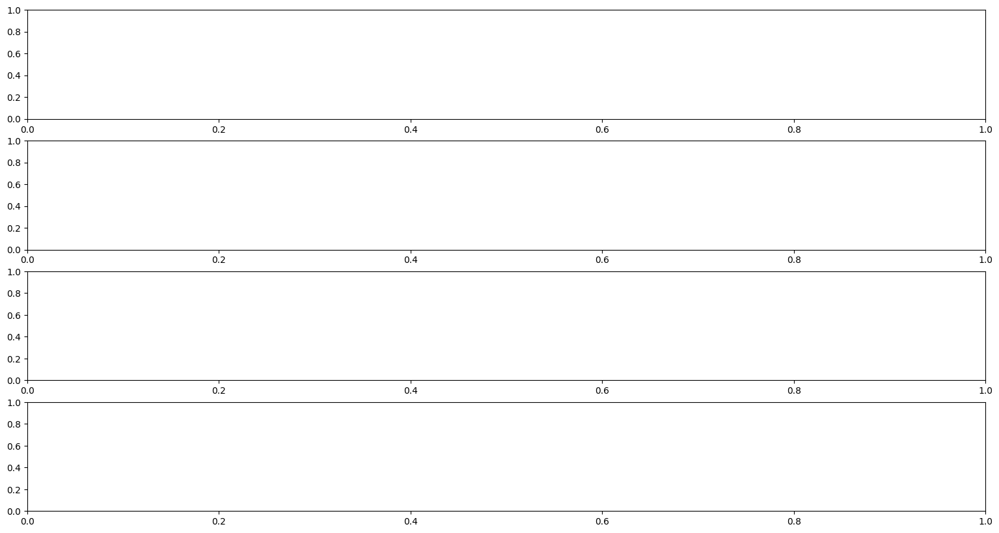

In [ ]:
import keras
import matplotlib.pyplot as plt
import matplotlib.cm as cm

fig, axs = plt.subplots(4, 1, figsize=(19, 10))
n=1
alpha=1

for ax, idx in zip(axs,id_100):
  img = images[idx]
  #heatmap = make_gradcam_heatmap(np.expand_dims(img, axis=0), new_model, 'block5_conv3' )
  heatmap = grad_cam(new_model, np.expand_dims(img, axis=0), layer_name="block5_conv3")


  heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
  heatmap = (heatmap*255).astype("uint8")
  heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
  superimposed_img = heatmap * alpha + img
  superimposed_img = np.clip(superimposed_img, 0, 255).astype("uint8")
  superimposed_img = cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

  #imgwithheat = Image.fromarray(superimposed_img)

  #superimposed_img = keras.utils.array_to_img(superimposed_img)
  print("superimposed_img",ax,"axe n-1", axs[n-1])
  ax.imshow(superimposed_img)
  ax.set_xticks([]), ax.set_yticks([])

  #for i, pred_ in enumerate(pred[idx]):
  #  print(round(pred_*100),"% for",label_enc.classes_[i])
  #print("\nCORRECT BREED =",label_enc.inverse_transform([np.argmax(pred[idx])])[0])
  #print(100*"*","\n")
  n+=1

plt.subplots_adjust(hspace = 0.1, wspace = 0.1)
plt.show()

In [ ]:
"""#all_preds = new_model.predict(images)
all_preds = new_model.predict(images)
all_labels = enc_label[:]
# randomise
random.seed(8)
random.shuffle(all_preds)
random.shuffle(all_labels)
#display a wrong prediction
for i, pred in enumerate(all_preds):
  print(i,pred,all_labels[i])
  if np.argmax(pred) != all_labels[i]:
    percents = [round(100*x) for x in pred]
    to_show = pd.DataFrame({"Categories" : label_enc.classes_,
              "Predictions" : percents},)
    break
to_show"""

In [ ]:
to_explain = ['block1_conv2', 'block2_conv2', 'block3_conv3', 'block4_conv3', 'block5_conv3']

In [ ]:
_analyse

Bad pred
Images/n02085936-Maltese_dog/n02085936_20076.jpg

Good pred
Images/n02090721-Irish_wolfhound/n02090721_519.jpg

Good one used
Images/n02088094-Afghan_hound/n02088094_1003.jpg

In [ ]:
import pandas as pd
cat = label_enc.classes_
pred = [round(100*x) for x in pred[]]
pd.DataFrame({"Categories" : cat,
              "id_photo" : pred},)

In [ ]:
type(images[0])

numpy.ndarray

In [ ]:
heatmap = grad_cam(new_model, images[0], layer_name='block5_conv3') #conv2d_187')

show_imgwithheat(_analyse, heatmap)

ValueError: ignored

In [ ]:
layers_name = [layer.name for layer in new_model2.layers]

['input_2',
 'conv2d_94',
 'batch_normalization_94',
 'activation_94',
 'conv2d_95',
 'batch_normalization_95',
 'activation_95',
 'conv2d_96',
 'batch_normalization_96',
 'activation_96',
 'max_pooling2d_4',
 'conv2d_97',
 'batch_normalization_97',
 'activation_97',
 'conv2d_98',
 'batch_normalization_98',
 'activation_98',
 'max_pooling2d_5',
 'conv2d_102',
 'batch_normalization_102',
 'activation_102',
 'conv2d_100',
 'conv2d_103',
 'batch_normalization_100',
 'batch_normalization_103',
 'activation_100',
 'activation_103',
 'average_pooling2d_9',
 'conv2d_99',
 'conv2d_101',
 'conv2d_104',
 'conv2d_105',
 'batch_normalization_99',
 'batch_normalization_101',
 'batch_normalization_104',
 'batch_normalization_105',
 'activation_99',
 'activation_101',
 'activation_104',
 'activation_105',
 'mixed0',
 'conv2d_109',
 'batch_normalization_109',
 'activation_109',
 'conv2d_107',
 'conv2d_110',
 'batch_normalization_107',
 'batch_normalization_110',
 'activation_107',
 'activation_110',
 

In [ ]:
heatmap_plus = grad_cam_plus(new_model, img_[0], layer_name="block4_conv3")
show_imgwithheat(_analyse, heatmap_plus)